<a href="https://colab.research.google.com/github/dilia-w/Visao-Computacional/blob/main/atividade_11_5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##05 - Filtro de Kalman Rastreamento com Oclusão

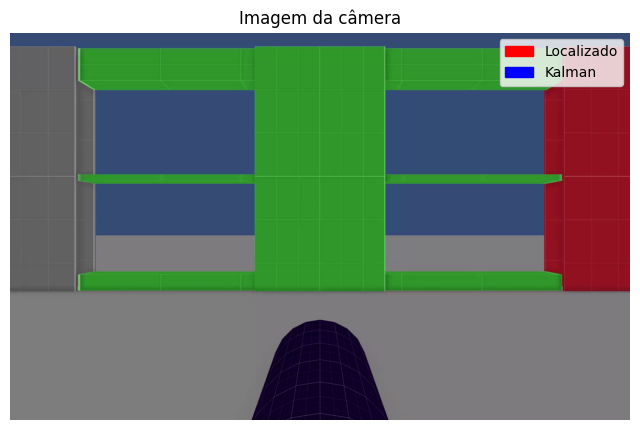

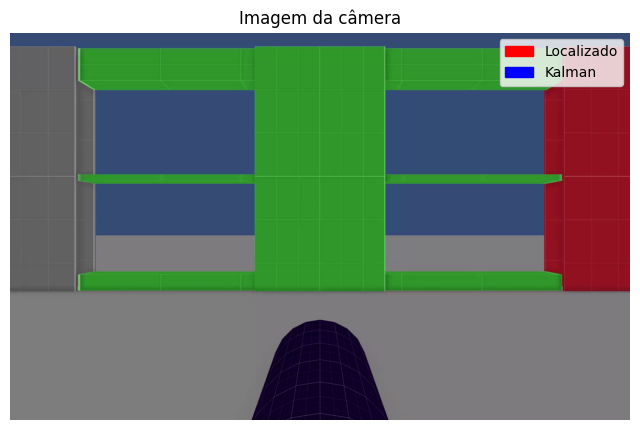

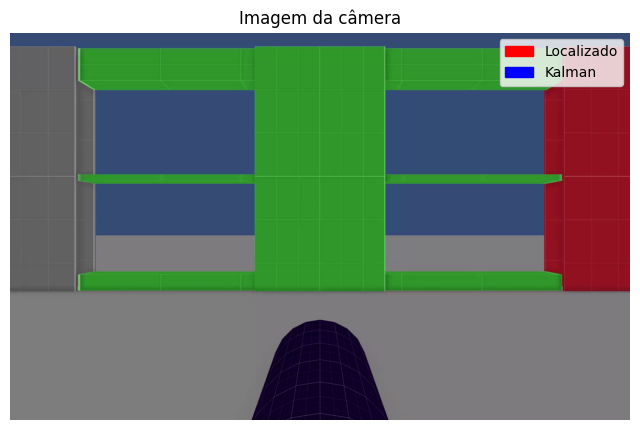

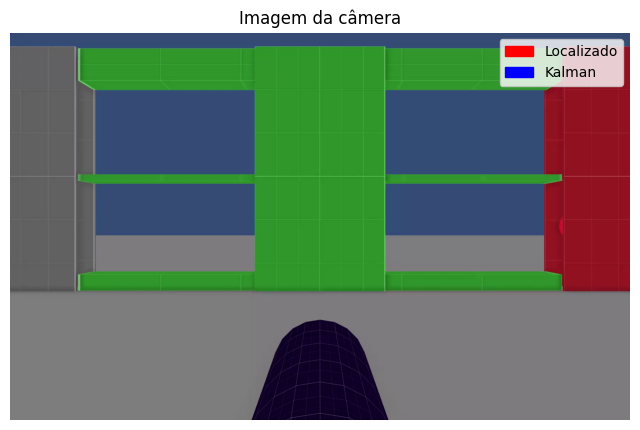

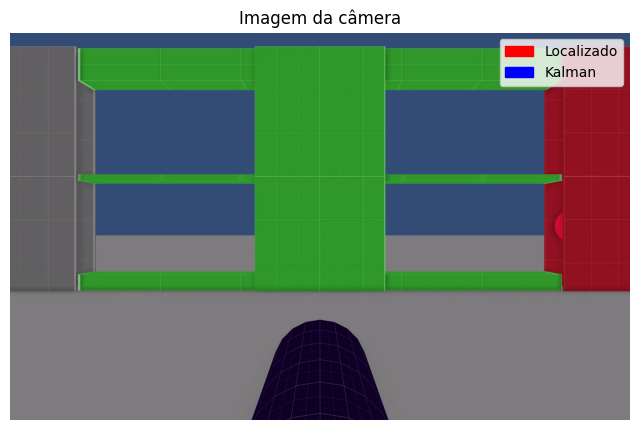

...

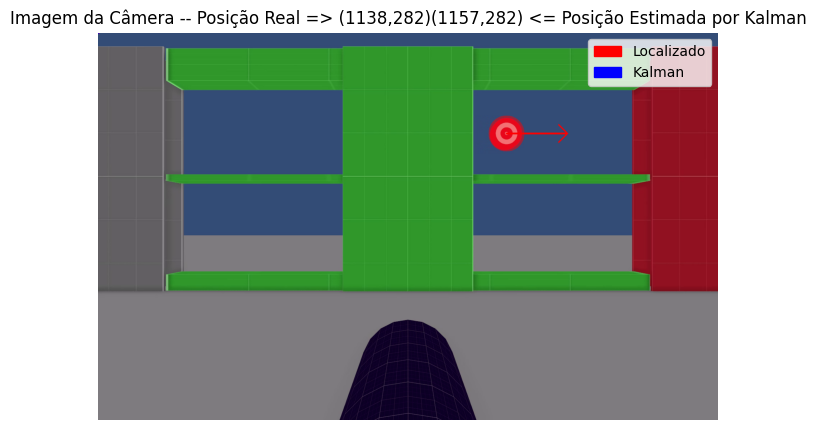

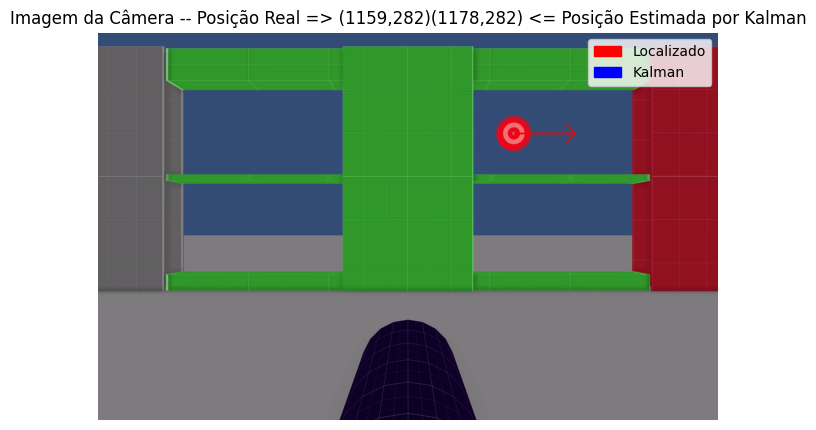

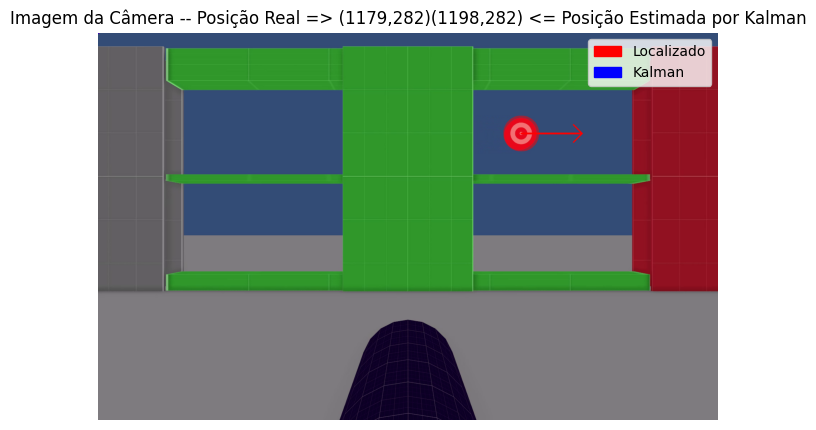

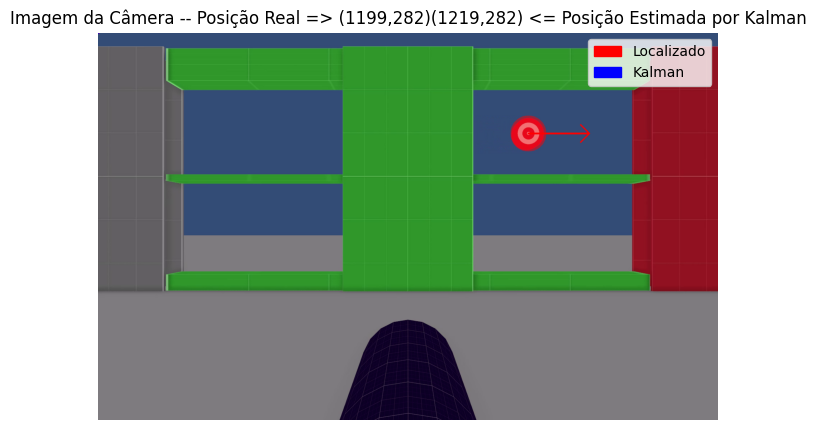

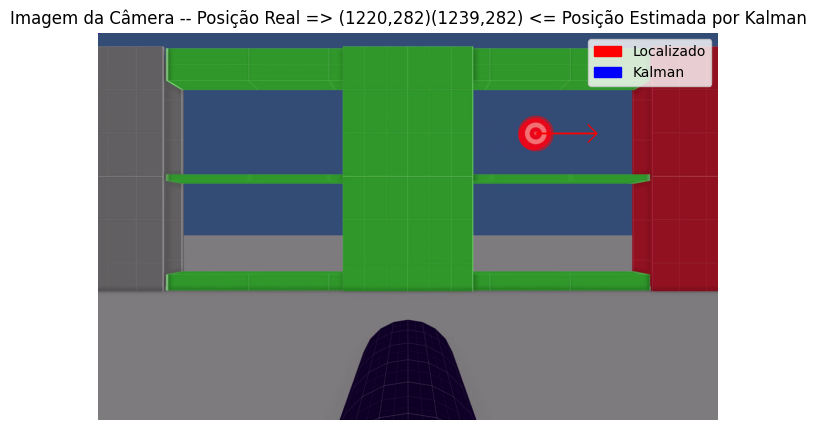

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def initialize_kalman():
    kalman = cv2.KalmanFilter(4, 2)
    dt = 1/30.0  # Video gerado com 30 fps
    dt_adjusted = dt * 4
    kalman.transitionMatrix = np.array([[1, 0, dt_adjusted, 0],
                                        [0, 1, 0, dt_adjusted],
                                        [0, 0, 1, 0],
                                        [0, 0, 0, 1]], np.float32)
    kalman.measurementMatrix = np.array([[1, 0, 0, 0],
                                         [0, 1, 0, 0]], np.float32)
    kalman.processNoiseCov = np.eye(4, 4, dtype=np.float32) * 1e-4
    kalman.measurementNoiseCov = np.eye(2, 2, dtype=np.float32) * 1e-1
    kalman.errorCovPost = np.eye(4, 4, dtype=np.float32)
    return kalman

def draw_transparent_circle(img, center, radius, color, alpha):
    overlay = img.copy()
    cv2.circle(overlay, center, radius, color, -1)
    return cv2.addWeighted(overlay, alpha, img, 1 - alpha, 0)

# Configuração para as marcações
box_color = (0, 255, 0)
box_thickness = 2
arrow_color = (0, 0, 255)
arrow_thickness = 4
arrow_size = 170
tipLength = 0.2
radius = 0
color_detected = (0, 0, 255)
color_predicted = (255, 0, 0)
thickness = -1
valores = []

x_center = 0
y_center = 0
max_x = 1440
min_x = 280
max_area = 2000

title_string = ('Imagem da câmera')

x_center_ant = None
esquerda = False
detectado = False
old_detectado = False
detected_point = None

kalman = initialize_kalman()

cap = cv2.VideoCapture('movie_002.mp4')
ret, prev_frame = cap.read()
prev_gray = cv2.cvtColor(prev_frame, cv2.COLOR_BGR2GRAY)
step_frames = 3

while True:
    current_position = cap.get(cv2.CAP_PROP_POS_FRAMES)
    cap.set(cv2.CAP_PROP_POS_FRAMES, current_position + step_frames)
    ret, frame = cap.read()
    if not ret:
        break

    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    diff = cv2.absdiff(prev_gray, gray)
    _, thresholded = cv2.threshold(diff, 25, 255, cv2.THRESH_BINARY)
    contours, _ = cv2.findContours(thresholded, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    if len(contours) > 6:
        largest_contour = max(contours, key=cv2.contourArea)
        if cv2.contourArea(largest_contour) > max_area:
            x, y, w, h = cv2.boundingRect(largest_contour)
            x_center = int((2*x+w)/2)
            y_center = int((2*y+h)/2)
            if x_center_ant is not None:
                direcao = x_center - x_center_ant
                if direcao > 0:
                    cv2.arrowedLine(frame, (x_center, y_center),
                       (x_center+arrow_size, y_center), arrow_color, arrow_thickness,
                       tipLength=tipLength)
                else:
                    cv2.arrowedLine(frame, (x_center, y_center),
                       (x_center-arrow_size, y_center), arrow_color, arrow_thickness,
                       tipLength=tipLength)
            x_center_ant = x_center
            detected_point = np.array([x_center, y_center], np.float32)
            radius = max(int(w/2), 50)
            max_area = cv2.contourArea(largest_contour) * .97
        else:
            detected_point = None

    if x_center > max_x or x_center < min_x:
        detectado = False
        max_area = 2000
    elif min_x < x_center < max_x:
        detectado = True
        if old_detectado is False:
            kalman = initialize_kalman()
            kalman.statePost = np.array([[detected_point[0]],
                            [detected_point[1]],
                            [0],
                            [0]], dtype=np.float32)
            predicted = kalman.predict()

    old_detectado = detectado

    plt.figure(figsize=(8, 8))

    if detected_point is not None and detectado:
        kalman.correct(detected_point)
        predicted = kalman.predict()
        frame = draw_transparent_circle(frame, (x_center, y_center), radius, color_detected, 0.5)
        title_string = f'Imagem da Câmera -- Posição Real => ({x_center},{y_center})({int(predicted[0])},{int(predicted[1])}) <= Posição Estimada por Kalman'
    elif detectado:
        predicted = kalman.predict()
        frame = draw_transparent_circle(frame, (int(predicted[0]), int(predicted[1])), radius, color_predicted, 0.5)
        title_string = f'Imagem da Câmera -- Posição Real => (???,???) ({int(predicted[0])},{int(predicted[1])}) <= Posição Estimada por Kalman'

    plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
    real_circle = plt.Circle((0, 0), 1, color=(1,0,0), fc=(1,0,0), ec=(1,0,0)) # circle for the real position
    predicted_circle = plt.Circle((0, 0), 1, color=(0,0,1), fc=(0,0,1), ec=(0,0,1)) # circle for the predicted position
    plt.gca().add_patch(real_circle)
    plt.gca().add_patch(predicted_circle)
    plt.legend([real_circle, predicted_circle], ['Localizado', 'Kalman'], loc="upper right")
    plt.title(title_string)
    plt.axis('off')
    plt.show()

cap.release()
plt.close()
